# EDA project

### Data, Client & Research Questions 

Data: House sale prices and characteristics for King County, which includes Seattle. It includes homes sold between May 2014 and May 2015.

Client:

- Nicole Johnson (Buyer) Lively, central neighborhood, middle price range, right timing (within a year)    

Research questions: 

1) Centrally located properties are more expensive
2) Lively neigbourhoods are more expensive
3) Viewed properties are more expensive

 ![Seattle skyline](https://upload.wikimedia.org/wikivoyage/en/thumb/d/d8/SeattleBanner3.jpg/1200px-SeattleBanner3.jpg?20160324004940)


### Key insights & recommedations 

| Key insight                                      | Recommendation                                                                                       |
| ------------------------------------------------ | ---------------------------------------------------------------------------------------------------- |
| Lively neighbourhoods are more expensive         | Nicole will pay more to be in a lively neighbourhood. 98102, 98109, 98122 are the most lively         |
| Centrally located properties are more expensive  | Nicole will pay more to live centrally                                                                |
| A large number of properties meet the client's criteria | Nicole has many properties to choose from                                                              |
| Very few properties that meet the criteria have already been viewed at least once | Past views may not be a useful proxy to indicate speed of moving process  |







### Importing the packages and loading the dataset

In [1]:
import warnings

warnings.filterwarnings("ignore")
import folium as fo
from folium.plugins import MarkerCluster
import pandas as pd
import numpy as np
from scipy.stats import f_oneway
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
from matplotlib.ticker import PercentFormatter
plt.rcParams.update({ "figure.figsize" : (8, 5),"axes.facecolor" : "white", "axes.edgecolor":  "black"})
plt.rcParams["figure.facecolor"]= "w"
pd.plotting.register_matplotlib_converters()
pd.set_option('display.float_format', lambda x: '%.3f' % x)


In [2]:
# We load the csv with the dataset and define as a pandas dataframe.
df = pd.read_csv('data/eda.csv')

### Understanding the Data

The initial aims of this section are to:
 
- Examine the descriptive statistics of the dataset.
- Check for missing values. Are they concentrated in some column or in some observations?
- Check which features are continuous or categorical.




In [3]:
pd.set_option('display.max_columns', 50)  # We want to display wide tables. 

Descriptive statistics


In [4]:
df.head()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,id.1
0,7129300520,3.000,1.000,1180.000,5650.000,1.000,NaN,0.000,3,7,1180.000,0.000,1955,0.000,98178,47.511,-122.257,1340.000,5650.000,2014-10-13,221900.000,7129300520,1
1,6414100192,3.000,2.250,2570.000,7242.000,2.000,0.000,0.000,3,7,2170.000,400.000,1951,19910.000,98125,47.721,-122.319,1690.000,7639.000,2014-12-09,538000.000,6414100192,2
2,5631500400,2.000,1.000,770.000,10000.000,1.000,0.000,0.000,3,6,770.000,0.000,1933,NaN,98028,47.738,-122.233,2720.000,8062.000,2015-02-25,180000.000,5631500400,3
3,2487200875,4.000,3.000,1960.000,5000.000,1.000,0.000,0.000,5,7,1050.000,910.000,1965,0.000,98136,47.521,-122.393,1360.000,5000.000,2014-12-09,604000.000,2487200875,4
4,1954400510,3.000,2.000,1680.000,8080.000,1.000,0.000,0.000,3,8,1680.000,0.000,1987,0.000,98074,47.617,-122.045,1800.000,7503.000,2015-02-18,510000.000,1954400510,5


In [5]:
df.tail()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,id.1
21592,263000018,3.000,2.500,1530.000,1131.000,3.000,0.000,0.000,3,8,1530.000,0.000,2009,0.000,98103,47.699,-122.346,1530.000,1509.000,2014-05-21,360000.000,263000018,21593
21593,6600060120,4.000,2.500,2310.000,5813.000,2.000,0.000,0.000,3,8,2310.000,0.000,2014,0.000,98146,47.511,-122.362,1830.000,7200.000,2015-02-23,400000.000,6600060120,21594
21594,1523300141,2.000,0.750,1020.000,1350.000,2.000,0.000,0.000,3,7,1020.000,0.000,2009,0.000,98144,47.594,-122.299,1020.000,2007.000,2014-06-23,402101.000,1523300141,21595
21595,291310100,3.000,2.500,1600.000,2388.000,2.000,NaN,0.000,3,8,1600.000,0.000,2004,0.000,98027,47.535,-122.069,1410.000,1287.000,2015-01-16,400000.000,291310100,21596
21596,1523300157,2.000,0.750,1020.000,1076.000,2.000,0.000,0.000,3,7,1020.000,0.000,2008,0.000,98144,47.594,-122.299,1020.000,1357.000,2014-10-15,325000.000,1523300157,21597


In [6]:
df['bedrooms'].info

<bound method Series.info of 0       3.000
1       3.000
2       2.000
3       4.000
4       3.000
         ... 
21592   3.000
21593   4.000
21594   2.000
21595   3.000
21596   2.000
Name: bedrooms, Length: 21597, dtype: float64>

In [7]:
df['date'].info

<bound method Series.info of 0        2014-10-13
1        2014-12-09
2        2015-02-25
3        2014-12-09
4        2015-02-18
            ...    
21592    2014-05-21
21593    2015-02-23
21594    2014-06-23
21595    2015-01-16
21596    2014-10-15
Name: date, Length: 21597, dtype: object>

In [8]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
id,21597.000,4580474287.771,2876735715.748,1000102.000,2123049175.000,3904930410.000,7308900490.000,9900000190.000
bedrooms,21597.000,3.373,0.926,1.000,3.000,3.000,4.000,33.000
bathrooms,21597.000,2.116,0.769,0.500,1.750,2.250,2.500,8.000
sqft_living,21597.000,2080.322,918.106,370.000,1430.000,1910.000,2550.000,13540.000
sqft_lot,21597.000,15099.409,41412.637,520.000,5040.000,7618.000,10685.000,1651359.000
floors,21597.000,1.494,0.540,1.000,1.000,1.500,2.000,3.500
waterfront,19206.000,0.008,0.087,0.000,0.000,0.000,0.000,1.000
view,21534.000,0.234,0.766,0.000,0.000,0.000,0.000,4.000
condition,21597.000,3.410,0.651,1.000,3.000,3.000,4.000,5.000
grade,21597.000,7.658,1.173,3.000,7.000,7.000,8.000,13.000


In [9]:
# data cleaning step
# drop house_id and id.1

df = df.drop(columns=['house_id', 'id.1'])
df


,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price
0,7129300520,3.000,1.000,1180.000,5650.000,1.000,NaN,0.000,3,7,1180.000,0.000,1955,0.000,98178,47.511,-122.257,1340.000,5650.000,2014-10-13,221900.000
1,6414100192,3.000,2.250,2570.000,7242.000,2.000,0.000,0.000,3,7,2170.000,400.000,1951,19910.000,98125,47.721,-122.319,1690.000,7639.000,2014-12-09,538000.000
2,5631500400,2.000,1.000,770.000,10000.000,1.000,0.000,0.000,3,6,770.000,0.000,1933,NaN,98028,47.738,-122.233,2720.000,8062.000,2015-02-25,180000.000
3,2487200875,4.000,3.000,1960.000,5000.000,1.000,0.000,0.000,5,7,1050.000,910.000,1965,0.000,98136,47.521,-122.393,1360.000,5000.000,2014-12-09,604000.000
4,1954400510,3.000,2.000,1680.000,8080.000,1.000,0.000,0.000,3,8,1680.000,0.000,1987,0.000,98074,47.617,-122.045,1800.000,7503.000,2015-02-18,510000.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,3.000,2.500,1530.000,1131.000,3.000,0.000,0.000,3,8,1530.000,0.000,2009,0.000,98103,47.699,-122.346,1530.000,1509.000,2014-05-21,360000.000
21593,6600060120,4.000,2.500,2310.000,5813.000,2.000,0.000,0.000,3,8,2310.000,0.000,2014,0.000,98146,47.511,-122.362,1830.000,7200.000,2015-02-23,400000.000
21594,1523300141,2.000,0.750,1020.000,1350.000,2.000,0.000,0.000,3,7,1020.000,0.000,2009,0.000,98144,47.594,-122.299,1020.000,2007.000,2014-06-23,402101.000
21595,291310100,3.000,2.500,1600.000,2388.000,2.000,NaN,0.000,3,8,1600.000,0.000,2004,0.000,98027,47.535,-122.069,1410.000,1287.000,2015-01-16,400000.000


Missing data

In [10]:
# exploring missing data
df.isna().sum()
# We have missing data for waterfront, yr_renovated, sqft_basement, yr_renovated. 

id                  0
bedrooms            0
bathrooms           0
sqft_living         0
sqft_lot            0
floors              0
waterfront       2391
view               63
condition           0
grade               0
sqft_above          0
sqft_basement     452
yr_built            0
yr_renovated     3848
zipcode             0
lat                 0
long                0
sqft_living15       0
sqft_lot15          0
date                0
price               0
dtype: int64

<Axes: >

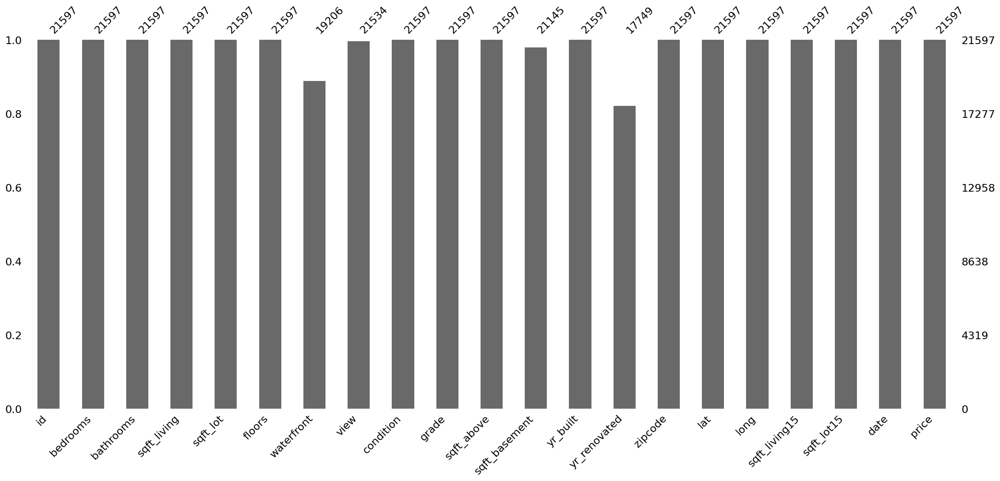

In [11]:
# We can see missing data visually.
msno.bar(df)

<Axes: >

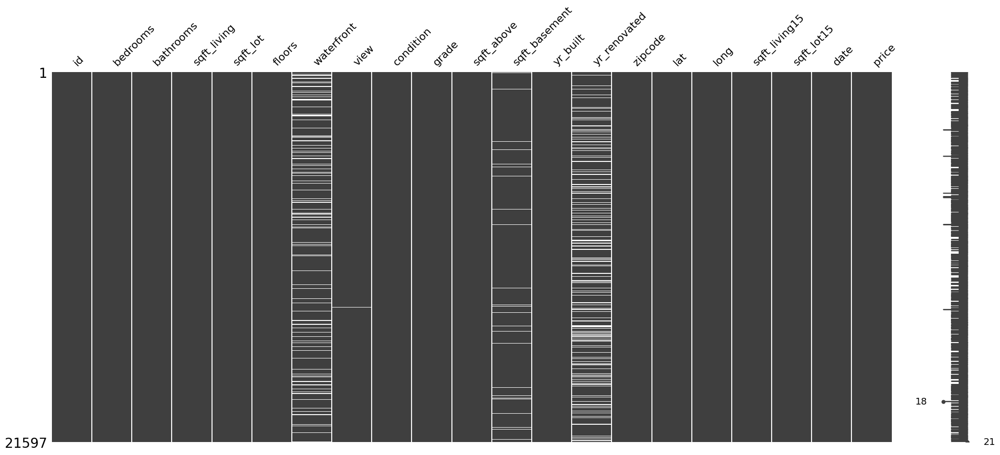

In [12]:
msno.matrix(df)

Handling missing data

In [13]:
# we drop rows where view is missing as there are relative few of them

df = df.dropna(subset=['view'])

Checking for categorical and continuous variables

In [14]:
categorical_columns = df.select_dtypes(include=['object'])
print("Categorical Columns:")
print(categorical_columns.columns)

# date needs to be converted to datetime format.

Categorical Columns:
Index(['date'], dtype='object')


In [15]:
numeric_columns = df.select_dtypes(include=['number'])
print("Numeric Columns:")
print(numeric_columns.columns)

Numeric Columns:
Index(['id', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'price'],
      dtype='object')


Variables that need to be transformed to categorical.

- condition
- grade

Variables that need to be transformed to integer

- bedrooms
- bathrooms
- floors

Variables that need be transformed to datetime
- yr_built
- yr_renovated

In [16]:
# Here we convert continuous variables to integers where needed 
df['bedrooms'] = df['bedrooms'].astype(int)
df['bathrooms'] = df['bathrooms'].astype(int)
df['floors'] = df['floors'].astype(int)
df['yr_built'] = df['yr_built'].astype(int)

# Here we convert continuous variables to catergorical or integers where needed.
df['view'] = df['view'].astype(int)
df['condition'] = df['condition'].astype(int)
df['grade'] = df['grade'].astype(int)
print(df.dtypes)

# Here we convert the years and date to the correct format. 
type(df['date'][0])
df['date'] = pd.to_datetime(df['date'])
type(df['date'][0])

id                 int64
bedrooms           int32
bathrooms          int32
sqft_living      float64
sqft_lot         float64
floors             int32
waterfront       float64
view               int32
condition          int32
grade              int32
sqft_above       float64
sqft_basement    float64
yr_built           int32
yr_renovated     float64
zipcode            int64
lat              float64
long             float64
sqft_living15    float64
sqft_lot15       float64
date              object
price            float64
dtype: object


pandas._libs.tslibs.timestamps.Timestamp

In [17]:
# checking duplicates
df.duplicated().value_counts()
# no duplicates of whole rows. No action required.

False    21534
Name: count, dtype: int64

Handling zipcodes

- We have 70 unique zipcodes. Seattle zipcodes range from 98101 to 98199.
As my client is interested living centrally I will filter my dataset to Seattle only: 98101, 98119.

In [18]:
#checking number of zipcodes. There are more than the number in Seattle meaning we have some from outside. 
df['zipcode'].nunique()

70

In [19]:
# We roughly group into urban outskirts, urban central, and suburban areas
df['zipcode'] = df['zipcode'].astype('string')
df["neighbourhood"] = df["zipcode"].apply(lambda x: "urban_outskirts" if x in ["98177","98178","98160","98155",
                                                       "98116","98136","98146","98166",
                                                       "98178","98188","98198","98199","98168",
                                                       "98158","98198","98156","98148"]
                     else "urban_central" if x in ["98133","98125","98107","98103","98125","98115","98105","98119",
                                                    "98109","98102","98112","98104","98122",
                                                   "98144","98134","98126","98106","98108","98116","98117"]
                    else "suburban")
df['neighbourhood'] = df['neighbourhood'].astype('category')



In [20]:
print(df['neighbourhood'].cat.categories)

Index(['suburban', 'urban_central', 'urban_outskirts'], dtype='object')


Further data preparation

In [21]:
# We explore the 'viewed' variable.
df['view'].info()
df['view'].nunique()
df['view'].unique()

df.reset_index(drop=True, inplace=True)

<class 'pandas.core.series.Series'>
Index: 21534 entries, 0 to 21596
Series name: view
Non-Null Count  Dtype
--------------  -----
21534 non-null  int32
dtypes: int32(1)
memory usage: 768.4 KB


In [22]:
# create variable price per square foot so we can compare differently sized properties.
df.eval('price_sqft = price / sqft_lot ', inplace = True)
df['price_sqft'].describe()

count   21534.000
mean       89.016
std        94.140
min         0.163
25%        33.333
50%        59.272
75%       107.614
max      2019.704
Name: price_sqft, dtype: float64

Supplementing data with external figures for population density

Average Population Density: 6692.357142857143
Median Population Density: 5933.0
Standard Deviation of Population Density: 3486.8774974953853


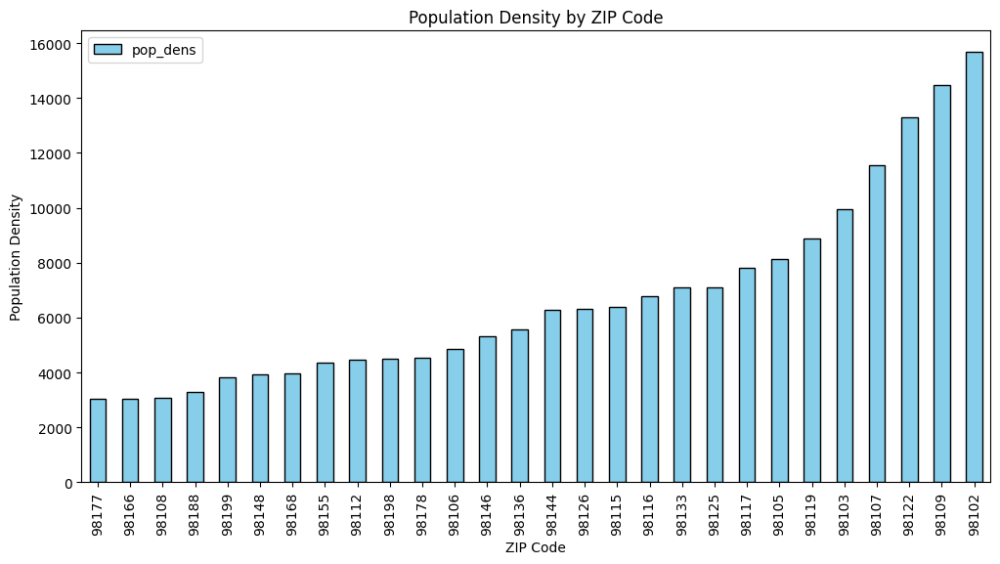

In [23]:
# we define a datset with external data for population density by zipcode. Source: https://zipatlas.com/us/wa/seattle/zip-code-comparison/highest-population-density.htm
data = {
    'zipcode': [98102, 98103, 98105, 98106, 98107, 98108, 98109, 98112, 98115, 98116, 98117, 98119, 98122, 98125, 98126, 98133, 98136, 98144, 98146, 98148, 98155, 98166, 98168, 98177, 98178, 98188, 98198, 98199],
    'pop_dens': [15668, 9952, 8145, 4844, 11540, 3071, 14452, 4452, 6384, 6764, 7799, 8867, 13280, 7101, 6316, 7088, 5581, 6285, 5322, 3941, 4361, 3036, 3950, 3027, 4518, 3294, 4513, 3835]
}

df_popd = pd.DataFrame(data)

# Ensure population density is a numerical data type (remove commas)
df_popd['pop_dens'] = df_popd['pop_dens'].replace(',', '', regex=True).astype(int)
df_popd_sorted = df_popd.sort_values(by='pop_dens', ascending=True)

# Calculate basic statistics
mean_pop_dens = df_popd['pop_dens'].mean()
median_pop_dens = df_popd['pop_dens'].median()
std_dev_pop_dens = df_popd['pop_dens'].std()

print("Average Population Density:", mean_pop_dens)
print("Median Population Density:", median_pop_dens)
print("Standard Deviation of Population Density:", std_dev_pop_dens)

# Plotting the population density
df_popd_sorted.plot(kind='bar', x='zipcode', y='pop_dens', color='skyblue', edgecolor='black', figsize=(12, 6))
plt.title('Population Density by ZIP Code')
plt.xlabel('ZIP Code')
plt.ylabel('Population Density')
plt.show()

In [24]:
# we merge with population density data and join by zipcode
df['zipcode'] = df['zipcode'].astype(int)
df_popd['zipcode'] = df_popd['zipcode'].astype(int)
df = pd.merge(df, df_popd, on='zipcode', how='left')
df.head()
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21534 entries, 0 to 21533
Data columns (total 24 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21534 non-null  int64         
 1   bedrooms       21534 non-null  int32         
 2   bathrooms      21534 non-null  int32         
 3   sqft_living    21534 non-null  float64       
 4   sqft_lot       21534 non-null  float64       
 5   floors         21534 non-null  int32         
 6   waterfront     19149 non-null  float64       
 7   view           21534 non-null  int32         
 8   condition      21534 non-null  int32         
 9   grade          21534 non-null  int32         
 10  sqft_above     21534 non-null  float64       
 11  sqft_basement  21084 non-null  float64       
 12  yr_built       21534 non-null  int32         
 13  yr_renovated   17698 non-null  float64       
 14  zipcode        21534 non-null  int32         
 15  lat            2153

In [25]:
# create variable price per square foot so we can compare differently sized properties.
df.eval('price_sqft = price / sqft_lot', inplace = True)
df.head()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,neighbourhood,price_sqft,pop_dens
0,7129300520,3,1,1180.000,5650.000,1,NaN,0,3,7,1180.000,0.000,1955,0.000,98178,47.511,-122.257,1340.000,5650.000,2014-10-13,221900.000,urban_outskirts,39.274,4518.000
1,6414100192,3,2,2570.000,7242.000,2,0.000,0,3,7,2170.000,400.000,1951,19910.000,98125,47.721,-122.319,1690.000,7639.000,2014-12-09,538000.000,urban_central,74.289,7101.000
2,5631500400,2,1,770.000,10000.000,1,0.000,0,3,6,770.000,0.000,1933,NaN,98028,47.738,-122.233,2720.000,8062.000,2015-02-25,180000.000,suburban,18.000,NaN
3,2487200875,4,3,1960.000,5000.000,1,0.000,0,5,7,1050.000,910.000,1965,0.000,98136,47.521,-122.393,1360.000,5000.000,2014-12-09,604000.000,urban_outskirts,120.800,5581.000
4,1954400510,3,2,1680.000,8080.000,1,0.000,0,3,8,1680.000,0.000,1987,0.000,98074,47.617,-122.045,1800.000,7503.000,2015-02-18,510000.000,suburban,63.119,NaN


In [26]:
# Define the condition for Seattle ZIP codes
seattle_zipcodes = (df['zipcode'] >= 98101) & (df['zipcode'] <= 98199)

# Keep only rows with ZIP codes within the Seattle range
df_seattle = df[seattle_zipcodes].copy()
df_seattle.reset_index(drop=True, inplace=True)
df_seattle.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8946 entries, 0 to 8945
Data columns (total 24 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             8946 non-null   int64         
 1   bedrooms       8946 non-null   int32         
 2   bathrooms      8946 non-null   int32         
 3   sqft_living    8946 non-null   float64       
 4   sqft_lot       8946 non-null   float64       
 5   floors         8946 non-null   int32         
 6   waterfront     7942 non-null   float64       
 7   view           8946 non-null   int32         
 8   condition      8946 non-null   int32         
 9   grade          8946 non-null   int32         
 10  sqft_above     8946 non-null   float64       
 11  sqft_basement  8744 non-null   float64       
 12  yr_built       8946 non-null   int32         
 13  yr_renovated   7296 non-null   float64       
 14  zipcode        8946 non-null   int32         
 15  lat            8946 n

In [27]:
# Define the number of bins
num_bins = 3

# Create bins based on quantiles
df_seattle['price_bins'] = pd.qcut(df_seattle['price'], q=num_bins)

# Define the labels for the bins
bin_labels = ['low', 'mid', 'high']

# Create a categorical variable with the specified bins and labels
df_seattle['price_category'] = pd.qcut(df_seattle['price'], q=num_bins, labels=bin_labels)

# Display unique categories
unique_categories = df_seattle['price_category'].unique()
print(unique_categories)

# Optionally, display the distribution of data points in each category
category_counts = df_seattle['price_category'].value_counts()
print(category_counts)


['low', 'mid', 'high']
Categories (3, object): ['low' < 'mid' < 'high']
price_category
low     2997
mid     2993
high    2956
Name: count, dtype: int64


In [28]:
# Define the number of bins
num_bins = 3

# Create bins based on quantiles
df_seattle['price_bins'] = pd.qcut(df_seattle['price_sqft'], q=num_bins)

# Define the labels for the bins
bin_labels = ['low', 'mid', 'high']

# Create a categorical variable with the specified bins and labels
df_seattle['price_sqft_category'] = pd.qcut(df_seattle['price_sqft'], q=num_bins, labels=bin_labels)

# Display unique categories
unique_categories = df_seattle['price_sqft_category'].unique()
print(unique_categories)

# Optionally, display the distribution of data points in each category
category_counts = df_seattle['price_sqft_category'].value_counts()
print(category_counts)


['low', 'mid', 'high']
Categories (3, object): ['low' < 'mid' < 'high']
price_sqft_category
low     2982
mid     2982
high    2982
Name: count, dtype: int64


In [29]:
num_bins = 3

# Create bins based on quantiles
df_seattle['pop_dens_bins'] = pd.qcut(df_seattle['pop_dens'], q=num_bins)

# Define the labels for the bins
bin_labels = ['low', 'mid', 'high']

# Create a categorical variable with the specified bins and labels
df_seattle['price_dens_category'] = pd.qcut(df_seattle['pop_dens'], q=num_bins, labels=bin_labels)

# Display unique categories
unique_categories = df_seattle['price_dens_category'].unique()
print(unique_categories)

# Optionally, display the distribution of data points in each category
category_counts = df_seattle['price_dens_category'].value_counts()
print(category_counts)

['low', 'high', 'mid', NaN]
Categories (3, object): ['low' < 'mid' < 'high']
price_dens_category
low     3058
high    2742
mid     2641
Name: count, dtype: int64


In [30]:
num_bins = 3
bin_labels = ['low', 'mid', 'high']

# Create a categorical variable with the specified bins and labels
df_seattle['pop_dens_category'] = pd.qcut(df_seattle['pop_dens'], q=num_bins, labels=bin_labels)

# Display the unique categories
print(df_seattle['pop_dens_category'].unique())

# Display the distribution of data points in each category
category_counts = df_seattle['pop_dens_category'].value_counts()
print(category_counts)

['low', 'high', 'mid', NaN]
Categories (3, object): ['low' < 'mid' < 'high']
pop_dens_category
low     3058
high    2742
mid     2641
Name: count, dtype: int64


### Exploring the data

- Check distributions of the continuous variables, for example by producing histograms for each of them.
- Check the distributions for the categorical variables, by producing plots/tables of counts.
- Look at the histograms and check for clues or patterns: can you identify groups, are the distributions skewed, do you have extreme values or outliers, where is the data centered. Do you need to remove some data?


__Exploring the data visually__

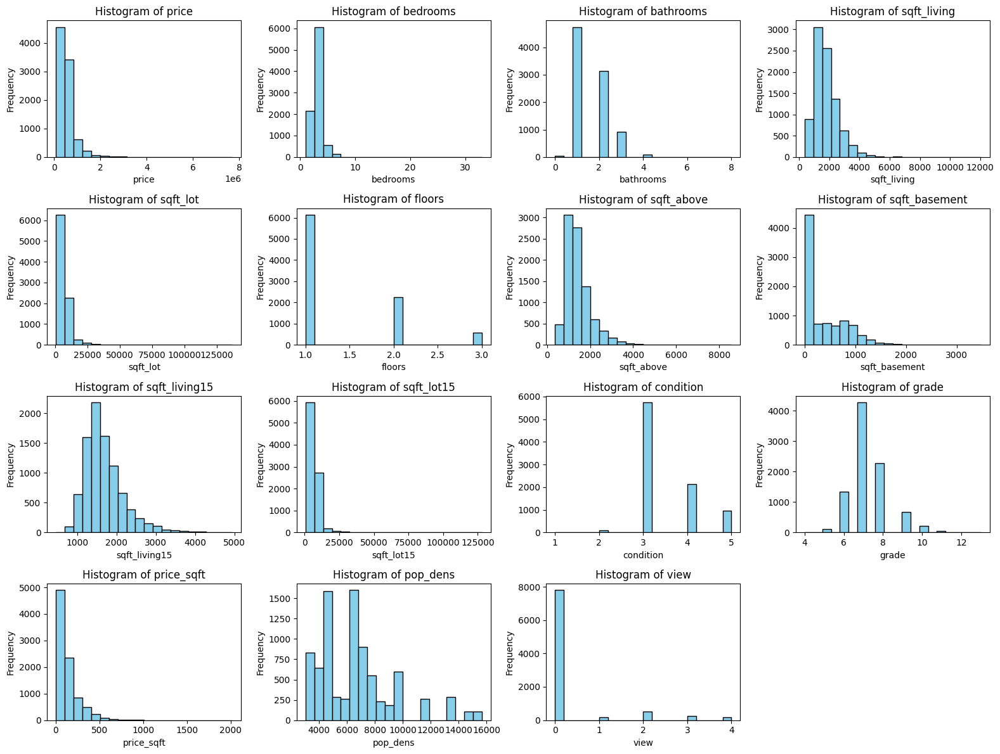

In [31]:
# List of variables to plot
columns = ['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 
           'floors', 'sqft_above', 'sqft_basement', 'sqft_living15', 
           'sqft_lot15', 'condition', 'grade', 'price_sqft', 'pop_dens','view']

# Create subplots
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(16, 12))
axes = axes.flatten()

# Plot histograms
for i, column in enumerate(columns):
    if i < len(axes):  # Check if within range of available axes
        df_seattle[column].plot(kind='hist', ax=axes[i], bins=20, color='skyblue', edgecolor='black')
        axes[i].set_title(f'Histogram of {column}')
        axes[i].set_xlabel(column)
        axes[i].set_ylabel('Frequency')

# Remove any unused subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


__Exploring the data with maps__

In [32]:
# House sales by neigbourhood type
# Define a color palette manually
color_palette = {
    'suburban': 'blue',
    'urban_central': 'green',
    'urban_outskirts': 'red'
}

# Initialize a Folium Map centered around the average location
m = fo.Map(location=[df_seattle['lat'].mean(), df_seattle['long'].mean()], zoom_start=12)

# Add markers to the map, color-coded by neighborhood
for idx, row in df_seattle.iterrows():
    neighborhood_color = color_palette.get(row['neighbourhood'], 'gray')  # Default to gray if neighborhood not found
    fo.CircleMarker(
        location=[row['lat'], row['long']],
        radius=1,  # Adjust marker size
        color=neighborhood_color,
        fill=True,
        fill_color=neighborhood_color,
        fill_opacity=1,
        popup=f"Neighborhood: {row['neighbourhood']}<br>Price: ${row['price']}"
    ).add_to(m)

# Save map to HTML file or display inline
m.save('map.html')

# If using a Jupyter Notebook, you can display it inline
from IPython.display import display
display(m)


In [33]:
# House sales by price 
# Define a color palette manually
color_palette = {
    'low': 'green',
    'mid': 'orange',
    'high': 'red'
}

# Initialize a Folium Map centered around the average location
m = fo.Map(location=[df_seattle['lat'].mean(), df_seattle['long'].mean()], zoom_start=12)

# Add markers to the map, color-coded by neighborhood
for idx, row in df_seattle.iterrows():
    price_color = color_palette.get(row['price_category'], 'gray')  # Default to gray if neighborhood not found
    fo.CircleMarker(
        location=[row['lat'], row['long']],
        radius=1,  # Adjust marker size
        color=price_color,
        fill=True,
        fill_color=price_color,
        fill_opacity=1,
        popup=f"Price: {row['price_category']}<br>Price: ${row['price']}"
    ).add_to(m)

# Save map to HTML file or display inline
m.save('map_price.html')

# If using a Jupyter Notebook, you can display it inline
from IPython.display import display
display(m)

__Descriptive statistics of neighbourhoods and price categories__

We present descriptive statistics for the sale price for urban central, urban outskirts and surbuban areas.

In [34]:
df_seattle[df_seattle['neighbourhood'] == 'urban_central'].describe()[['price']].transpose()

,count,mean,min,25%,50%,75%,max,std
price,5297.000,587217.366,90000.000,388000.000,500000.000,672500.000,7700000.000,353642.408


In [35]:
df_seattle[df_seattle['neighbourhood'] == 'urban_outskirts'].describe()[['price']].transpose()

,count,mean,min,25%,50%,75%,max,std
price,3144.000,465222.609,78000.000,270712.500,385000.000,560000.000,4500000.000,314481.410


In [36]:
df_seattle[df_seattle['neighbourhood'] == 'suburban'].describe()[['price']].transpose()

,count,mean,min,25%,50%,75%,max,std
price,505.000,418357.160,109000.000,290000.000,367500.000,476500.000,2900000.000,226333.225


We present descriptive statistics for the sale price for price categories low, mid & high.

In [37]:
df_seattle[df_seattle['price_category'] == 'low'].describe()[['price']].transpose()

,count,mean,min,25%,50%,75%,max,std
price,2997.000,284267.379,78000.000,240000.000,294000.000,338000.000,375000.000,63799.609


In [38]:
df_seattle[df_seattle['price_category'] == 'mid'].describe()[['price']].transpose()

,count,mean,min,25%,50%,75%,max,std
price,2993.000,461603.013,375500.000,415000.000,455000.000,505000.000,560000.000,53264.874


In [39]:
df_seattle[df_seattle['price_category'] == 'high'].describe()[['price']].transpose()

,count,mean,min,25%,50%,75%,max,std
price,2956.000,862954.494,561000.000,631593.750,727330.000,925000.000,7700000.000,408232.628


We present the descriptive statistic for low, mid and high population densities. 

In [40]:
df_seattle[df_seattle['pop_dens_category'] == 'low' ].describe()[['price']].transpose()

,count,mean,min,25%,50%,75%,max,std
price,3058.000,484187.269,78000.000,268000.000,359800.000,550000.000,4500000.000,389044.379


In [41]:
df_seattle[df_seattle['pop_dens_category'] == 'mid' ].describe()[['price']].transpose()

,count,mean,min,25%,50%,75%,max,std
price,2641.000,511054.914,82000.000,355000.000,447500.000,599000.000,3600000.000,260666.395


In [42]:
df_seattle[df_seattle['pop_dens_category'] == 'high' ].describe()[['price']].transpose()

,count,mean,min,25%,50%,75%,max,std
price,2742.000,635597.949,125000.000,449237.500,555000.000,714375.000,7700000.000,343644.999


### Relationships in the data

- Compute the correlation matrix and plot it.
- Check the relationships between the values in your hypothesis and the targe (price)
- Are all the conclusions expected or unexpected?
- If helpful create new features by combining existing ones, e.g. if you have distance and time you could derive the speed.



__Correlation matrix__

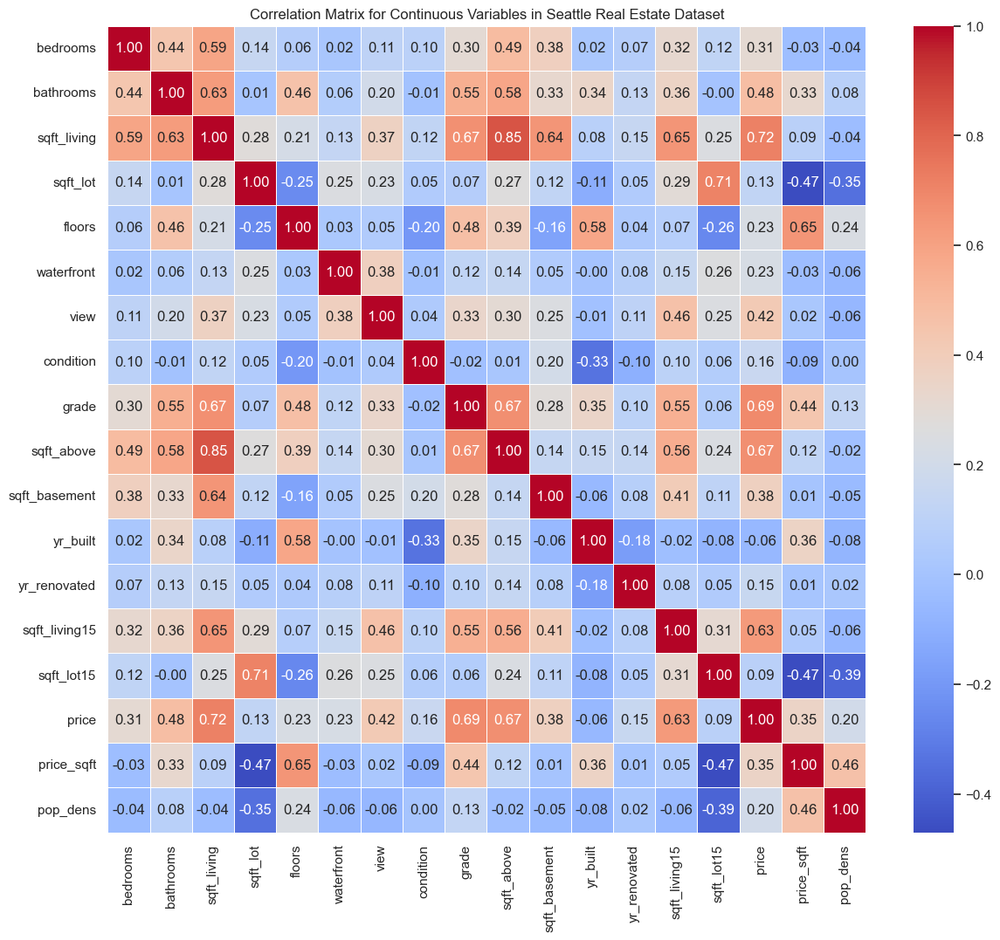

               bedrooms  bathrooms  sqft_living  sqft_lot  floors  waterfront  \
bedrooms          1.000      0.437        0.587     0.145   0.065       0.017   
bathrooms         0.437      1.000        0.625     0.011   0.456       0.063   
sqft_living       0.587      0.625        1.000     0.277   0.214       0.134   
sqft_lot          0.145      0.011        0.277     1.000  -0.248       0.252   
floors            0.065      0.456        0.214    -0.248   1.000       0.025   
waterfront        0.017      0.063        0.134     0.252   0.025       1.000   
view              0.109      0.201        0.370     0.235   0.052       0.382   
condition         0.096     -0.006        0.122     0.048  -0.205      -0.006   
grade             0.300      0.551        0.665     0.070   0.476       0.118   
sqft_above        0.494      0.582        0.847     0.269   0.385       0.140   
sqft_basement     0.383      0.325        0.645     0.124  -0.156       0.050   
yr_built          0.019     

In [50]:
# Dropping non-continuous columns for correlation matrix
continuous_vars = df_seattle.drop(columns=['id', 'zipcode', 'lat', 'long',
       'date','neighbourhood', 'price_bins', 'price_category',
       'price_sqft_category', 'pop_dens_bins', 'price_dens_category',
       'pop_dens_category'])

# Calculating the correlation matrix
correlation_matrix = continuous_vars.corr()

# Plotting the correlation matrix
plt.figure(figsize=(14, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix for Continuous Variables in Seattle Real Estate Dataset')
plt.show()

print(correlation_matrix)

__Population density vs. price per square foot__

We see positive correlation between population density and  price

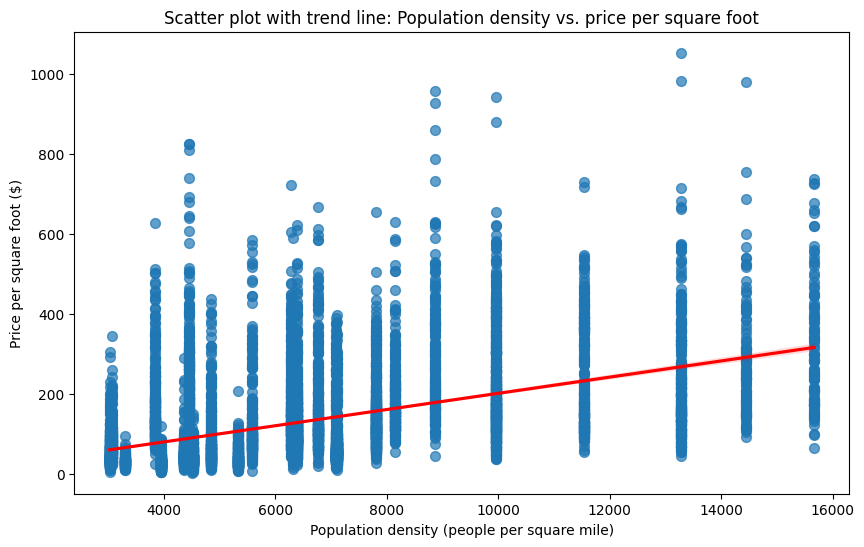

In [43]:
df_filtered = df_seattle[
    (df_seattle['price_sqft'] <= 1250)             # Include only <= 1250
]

# Create a scatter plot with a trend line
plt.figure(figsize=(10, 6))  # figure size 

sns.regplot(
    data=df_filtered,   # filtered DataFrame
    x='pop_dens',       # X-axis: Population density
    y='price_sqft',     # Y-axis: Price per square foot
    scatter=True,       # Show the scatter plot
    line_kws={'color': 'red'},  # Trend line color
    scatter_kws={'s': 50, 'alpha': 0.7}  # plot settings
)

# Set plot labels and title
plt.xlabel("Population density (people per square mile)")
plt.ylabel("Price per square foot ($)")
plt.title("Scatter plot with trend line: Population density vs. price per square foot")

# Show the plot
plt.show()

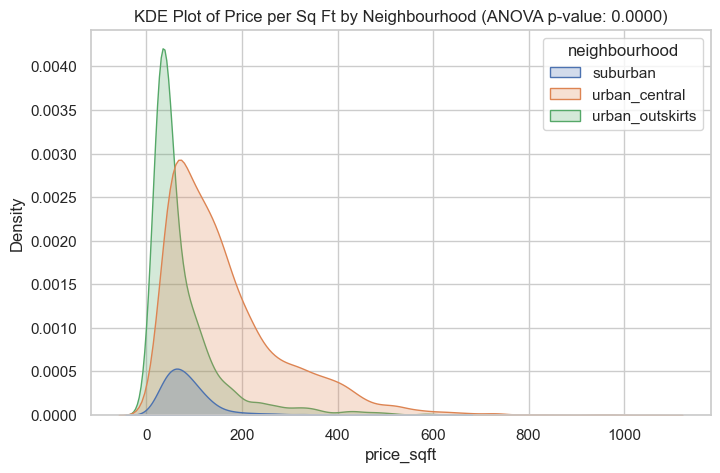

In [44]:

# Create a KDE plot with different colors for each neighbourhood
sns.set_theme(style="whitegrid")
ax = sns.kdeplot(data=df_filtered, x="price_sqft", hue="neighbourhood", fill=True)

# Calculate one-way ANOVA to determine if there's a significant difference in 'price_sqft' among 'neighbourhood'
neighbourhoods = df_filtered['neighbourhood'].unique()
price_sqft_values = [df_filtered[df_filtered['neighbourhood'] == n]['price_sqft'] for n in neighbourhoods]
anova_result = f_oneway(*price_sqft_values)

# Extract the p-value
p_value = anova_result.pvalue

# plot title 
ax.set_title(f"KDE Plot of Price per Sq Ft by Neighbourhood (ANOVA p-value: {p_value:.4f})")

# Show the plot
plt.show()

### Filtered dataset that meets client's criteria

In [45]:
df_filtered2 = df_seattle[
    (df_seattle['neighbourhood'] == 'urban_central') &
    (df_seattle['price_category'] == 'mid') &
    (df_seattle['pop_dens_category'] == 'high') &
    (df_seattle['view'] > 0)
]

# Get descriptive statistics for 'price'
price_stats = df_filtered2['price'].describe()

df_filtered2.describe()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,price_sqft,pop_dens
count,30.000,30.000,30.000,30.000,30.000,30.000,24.000,30.000,30.000,30.000,30.000,28.000,30.000,22.000,30.000,30.000,30.000,30.000,30.000,30,30.000,30.000,30.000
mean,5822915650.533,2.633,1.500,1499.000,4396.333,1.367,0.000,2.133,3.433,7.200,1165.667,290.000,1948.300,0.000,98112.067,47.675,-122.341,1792.333,4622.133,2014-09-18 16:00:00,482782.700,151.757,9439.200
min,455000841.000,1.000,1.000,770.000,1103.000,1.000,0.000,1.000,3.000,6.000,770.000,0.000,1900.000,0.000,98102.000,47.617,-122.387,1080.000,1188.000,2014-05-15 00:00:00,397500.000,28.936,7101.000
25%,1972202013.250,2.000,1.000,1007.500,2972.000,1.000,0.000,2.000,3.000,7.000,840.000,0.000,1920.250,0.000,98103.000,47.654,-122.361,1440.000,3075.000,2014-07-01 06:00:00,438125.000,93.110,7799.000
50%,6697100797.500,3.000,1.000,1435.000,3450.000,1.000,0.000,2.000,3.000,7.000,1040.000,140.000,1933.000,0.000,98107.000,47.672,-122.352,1785.000,4215.500,2014-09-01 00:00:00,487475.000,140.946,9952.000
75%,9324800453.750,3.000,2.000,1637.500,5806.750,1.000,0.000,2.000,4.000,7.750,1250.000,610.000,1980.500,0.000,98119.000,47.697,-122.308,1992.500,5800.000,2014-11-04 12:00:00,516132.750,176.731,9952.000
max,9828200147.000,5.000,3.000,4460.000,13737.000,3.000,0.000,3.000,5.000,10.000,3280.000,1090.000,2015.000,0.000,98125.000,47.733,-122.281,2790.000,10860.000,2015-04-10 00:00:00,560000.000,435.177,15668.000
std,3639008543.771,0.809,0.731,736.419,2686.261,0.718,0.000,0.507,0.568,0.805,503.099,369.925,36.561,0.000,9.135,0.030,0.033,416.791,2560.405,NaN,44453.554,90.576,2034.649


In [46]:
df_filtered3 = df_seattle[
    (df_seattle['neighbourhood'] == 'urban_central') &
    (df_seattle['price_category'] == 'mid') &
    (df_seattle['pop_dens_category'] == 'high')
]

df_filtered3.describe()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,price_sqft,pop_dens
count,1098.000,1098.000,1098.000,1098.000,1098.000,1098.000,995.000,1098.000,1098.000,1098.000,1098.000,1079.000,1098.000,899.000,1098.000,1098.000,1098.000,1098.000,1098.000,1098,1098.000,1098.000,1098.000
mean,4529084958.531,2.825,1.495,1428.059,4065.090,1.495,0.000,0.058,3.365,7.201,1194.291,232.092,1955.209,753.637,98113.518,47.675,-122.343,1496.998,4229.170,2014-10-16 12:07:52.131147520,473013.395,186.083,9552.374
min,7600057.000,1.000,0.000,540.000,651.000,1.000,0.000,0.000,1.000,5.000,540.000,0.000,1900.000,0.000,98102.000,47.602,-122.403,460.000,1021.000,2014-05-02 00:00:00,375950.000,15.994,7101.000
25%,2126049110.500,2.000,1.000,1150.000,1619.500,1.000,0.000,0.000,3.000,7.000,960.000,0.000,1924.000,0.000,98105.000,47.662,-122.371,1320.000,2184.750,2014-07-16 00:00:00,430000.000,86.411,7799.000
50%,3546419578.000,3.000,1.000,1380.000,3780.000,1.000,0.000,0.000,3.000,7.000,1160.000,0.000,1947.000,0.000,98117.000,47.679,-122.348,1460.000,4000.000,2014-10-01 00:00:00,473000.000,132.240,8867.000
75%,7228500597.500,3.000,2.000,1620.000,5150.000,2.000,0.000,0.000,4.000,8.000,1380.000,420.000,2001.000,0.000,98122.000,47.695,-122.311,1630.000,5225.000,2015-01-15 18:00:00,520000.000,279.397,11540.000
max,9828702667.000,8.000,5.000,4460.000,29699.000,3.000,0.000,3.000,5.000,10.000,3440.000,1500.000,2015.000,20140.000,98125.000,47.734,-122.267,2790.000,18000.000,2015-05-13 00:00:00,560000.000,718.499,15668.000
std,2922392212.312,0.838,0.653,425.808,2751.402,0.756,0.000,0.358,0.626,0.677,328.647,319.147,37.644,3803.567,8.478,0.032,0.034,269.560,2294.567,NaN,51875.688,135.404,2279.416


In [49]:
df_seattle.columns

Index(['id', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'date', 'price', 'neighbourhood',
       'price_sqft', 'pop_dens', 'price_bins', 'price_category',
       'price_sqft_category', 'pop_dens_bins', 'price_dens_category',
       'pop_dens_category'],
      dtype='object')